In [1]:
%load_ext autoreload
%autoreload 2

# Comparisons - Schedulers


In [2]:
from tabulate import tabulate
import numpy as np
from matplotlib import pyplot as plt

from src import helpers, interactive

PyTorch version: 2.0.1+cu117


GridBox(children=(Dropdown(description='model', index=2, layout=Layout(width='95%'), options=('stabilityai/sta…

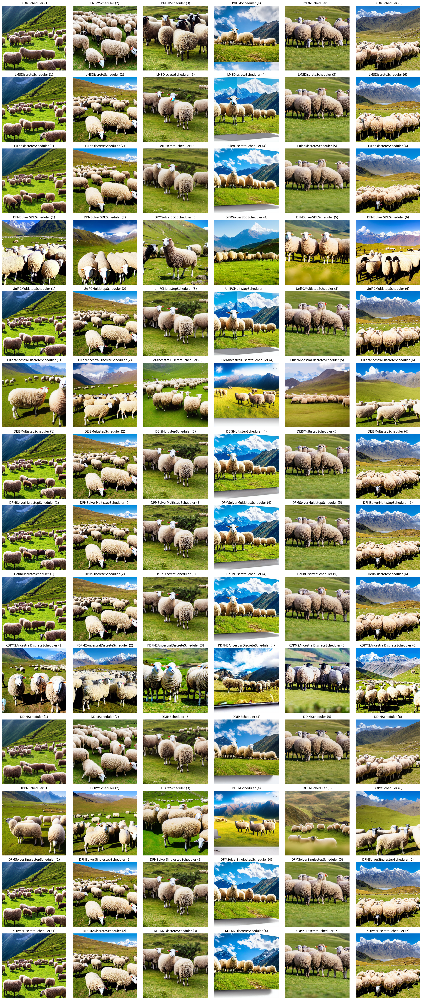

Scheduler                          Process Time (s)
-------------------------------  ------------------
PNDMScheduler                               9.90624
LMSDiscreteScheduler                        9.75929
EulerDiscreteScheduler                      9.18501
DPMSolverSDEScheduler                      17.4439
UniPCMultistepScheduler                     9.30995
EulerAncestralDiscreteScheduler             9.26248
DEISMultistepScheduler                      9.25286
DPMSolverMultistepScheduler                 9.2204
HeunDiscreteScheduler                      17.0525
KDPM2AncestralDiscreteScheduler            16.9332
DDIMScheduler                               9.29506
DDPMScheduler                               9.26706
DPMSolverSinglestepScheduler                9.34439
KDPM2DiscreteScheduler                     17.0037


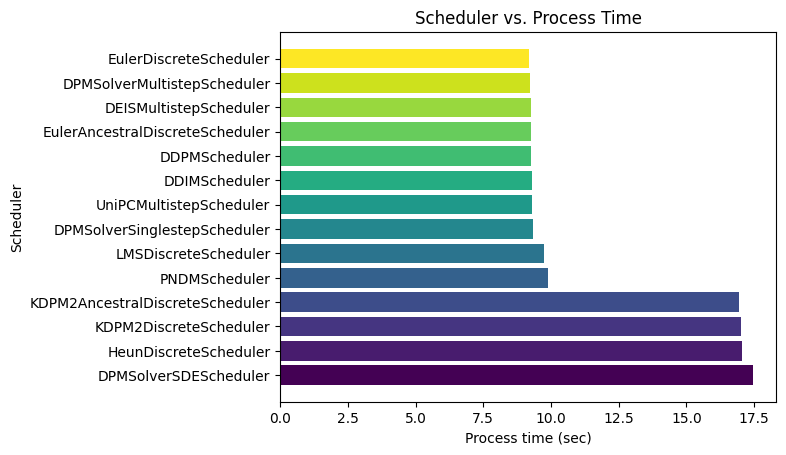

In [ ]:
icp = interactive.InteractivePipeline()
# We don't want to change the scheduler through the UI
icp.w_scheduler.layout.visibility = "hidden"
# We want the same seed for all runs
icp.w_seed.disabled = True
icp.w_seed.value = 123


def run_btn_callback():
    # Function to run when the Run button is pressed
    imgs, captions, scheduler_names, process_times = [], [], [], []

    # Looping through all the compatible schedulers
    # (the interactive pipeline automatically updates the scheduler options based on the model selected)
    for s in icp.w_scheduler.options:
        # Manually running the pipeline for current scheduler
        _imgs, _process_time = icp(scheduler=s, return_time_elapsed=True,)
        imgs.extend(_imgs)
        
        _s_name = s.__name__
        scheduler_names.append(_s_name)
        process_times.append(_process_time)
        captions.extend(
            [f"{_s_name} ({i + 1})" for i in range(icp.num_images_per_prompt)]
        )

    icp.show()
    helpers.plot(
        imgs,
        captions=captions,
        n_rows=len(icp.w_scheduler.options),
        fname="plot_grid_schedulers",
    )
    
    print(
        tabulate(zip(scheduler_names, process_times), headers=["Scheduler", "Process Time (s)"])
    )

    process_times, scheduler_names = zip(*sorted(zip(process_times, scheduler_names), reverse=True))
    color = plt.cm.viridis(np.linspace(0, 1, len(process_times)))

    plt.barh(scheduler_names, process_times, color=color)
    plt.xlabel("Process time (sec)")
    plt.ylabel("Scheduler")
    plt.title(f"Scheduler vs. Process Time")
    plt.show()


# We bind our callback function to the run button
icp.on_run = run_btn_callback
icp.show()